In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!pip install easyocr

     |████████████████████████████████| 63.0MB 43kB/s 


In [ ]:
!tar xzvf /content/gdrive/MyDrive/darknet/cudnn/cudnn-10.1-linux-x64-v8.0.4.30.tgz -C /usr/local/

cuda/include/cudnn.h
cuda/include/cudnn_adv_infer.h
cuda/include/cudnn_adv_train.h
cuda/include/cudnn_backend.h
cuda/include/cudnn_cnn_infer.h
cuda/include/cudnn_cnn_train.h
cuda/include/cudnn_ops_infer.h
cuda/include/cudnn_ops_train.h
cuda/include/cudnn_version.h
cuda/NVIDIA_SLA_cuDNN_Support.txt
cuda/lib64/libcudnn.so
cuda/lib64/libcudnn.so.8
cuda/lib64/libcudnn.so.8.0.4
cuda/lib64/libcudnn_adv_infer.so
cuda/lib64/libcudnn_adv_infer.so.8
cuda/lib64/libcudnn_adv_infer.so.8.0.4
cuda/lib64/libcudnn_adv_train.so
cuda/lib64/libcudnn_adv_train.so.8
cuda/lib64/libcudnn_adv_train.so.8.0.4
cuda/lib64/libcudnn_cnn_infer.so
cuda/lib64/libcudnn_cnn_infer.so.8
cuda/lib64/libcudnn_cnn_infer.so.8.0.4
cuda/lib64/libcudnn_cnn_train.so
cuda/lib64/libcudnn_cnn_train.so.8
cuda/lib64/libcudnn_cnn_train.so.8.0.4
cuda/lib64/libcudnn_ops_infer.so
cuda/lib64/libcudnn_ops_infer.so.8
cuda/lib64/libcudnn_ops_infer.so.8.0.4
cuda/lib64/libcudnn_ops_train.so
cuda/lib64/libcudnn_ops_train.so.8
cuda/lib64/libcudnn_o

In [ ]:
!cat /usr/local/cuda/include/cudnn_version.h | grep CUDNN_MAJOR -A 2

#define CUDNN_MAJOR 8
#define CUDNN_MINOR 0
#define CUDNN_PATCHLEVEL 4
--
#define CUDNN_VERSION (CUDNN_MAJOR * 1000 + CUDNN_MINOR * 100 + CUDNN_PATCHLEVEL)

#endif /* CUDNN_VERSION_H */


In [ ]:
cd /content/gdrive/MyDrive

/content/gdrive/MyDrive


In [ ]:
import cv2
# import pytesseract
import easyocr
# from pytesseract import Output
import numpy as np
try:
    import Image
except ImportError:
    from PIL import Image
import seaborn as sns
from matplotlib import pyplot as plt
import pandas as pd
import time
import glob 
# If you don't have tesseract executable in your PATH, include the following:
# to know about your path, please execute $ brew list [pkg-name] e.g. brew list tesseract
# pytesseract.pytesseract.tesseract_cmd = r'/usr/local/Cellar/tesseract/4.1.1/bin/tesseract'

[([[131, 187], [337, 187], [337, 229], [131, 229]], '돈수라화곡점', 0.9814079934415744), ([[130, 225], [338, 225], [338, 263], [130, 263]], '109-15-37467', 0.9999812793315291), ([[363, 224], [736, 224], [736, 272], [363, 272]], '7.-:02) 868-6930 임재목', 0.20454697506841946), ([[124, 258], [594, 258], [594, 308], [124, 308]], '서물특별시 강서구 원정로 96', 0.3008558784431765), ([[125, 341], [219, 341], [219, 383], [125, 383]], '테 이', 0.9712628722190857), ([[231, 343], [271, 343], [271, 385], [231, 385]], '틀', 0.6458917745352757), ([[313, 343], [389, 343], [389, 385], [313, 385]], '=늘]]', 0.0027436113450676203), ([[410, 344], [628, 344], [628, 392], [410, 392]], '(포장2)', 0.9716607422306692), ([[128, 380], [274, 380], [274, 428], [128, 428]], '고 객 수', 0.9626802334827893), ([[312, 380], [427, 380], [427, 435], [312, 435]], '내국인', 0.9947187567300447), ([[482, 388], [674, 388], [674, 436], [482, 436]], '1명) 외국인', 0.46820077168045604), ([[727, 391], [799, 391], [799, 435], [727, 435]], '(명)', 0.9740902132526252

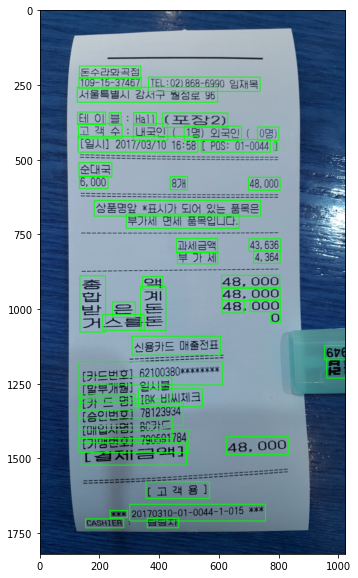

In [ ]:
# phone-pic
reader = easyocr.Reader(['ko'], gpu=True) # GPU 사용
result = reader.readtext('./영수증_1/01.jpg')
print(result)
img = cv2.imread('./영수증_1/01.jpg')

n_boxes = len(result)
for i in range(n_boxes):
    if result[i][2] > 0:
        (x, y, w, h) = (result[i][0][3][0], result[i][0][0][1], result[i][0][1][0]-result[i][0][3][0], result[i][0][2][1]-result[i][0][0][1])
        img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

# cv2.imshow('img', img)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

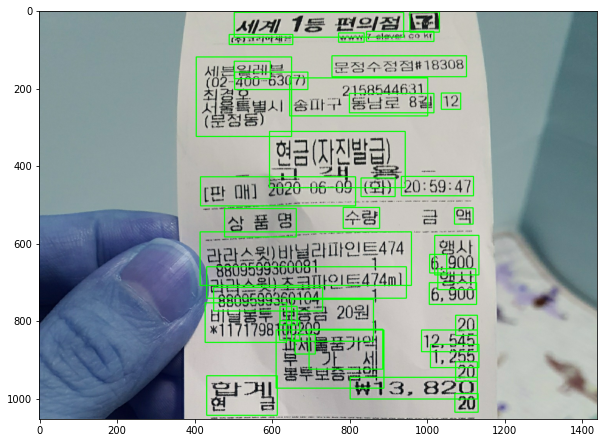

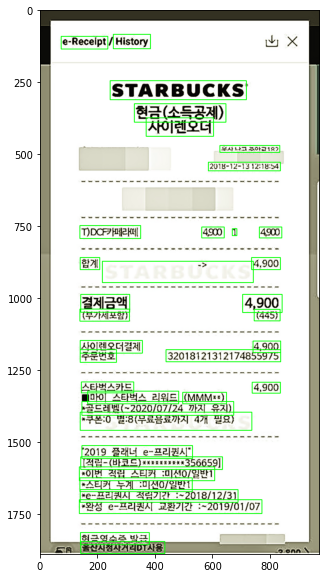

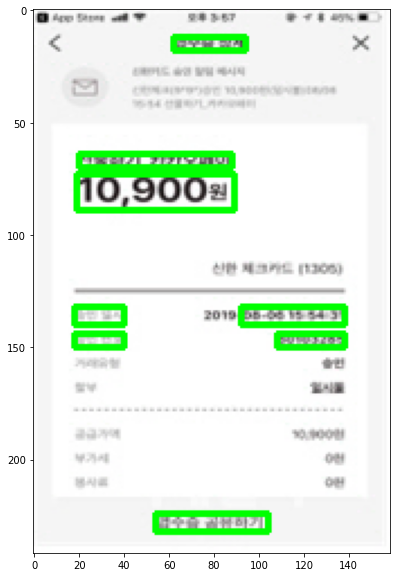

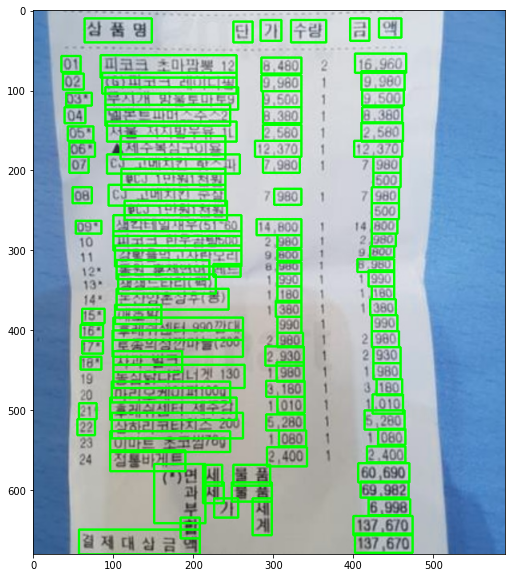

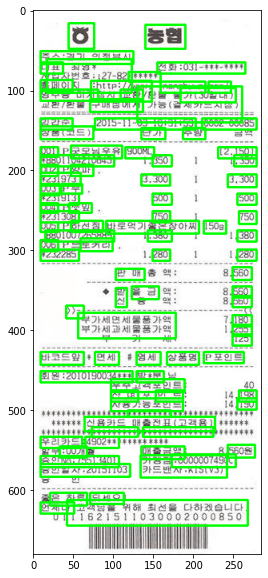

...

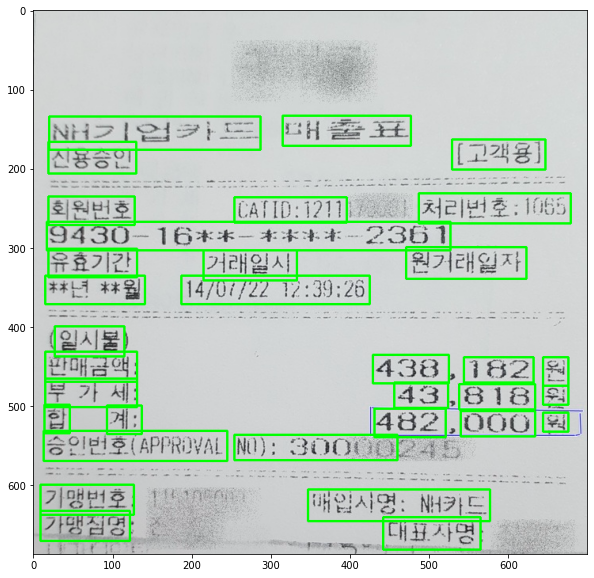

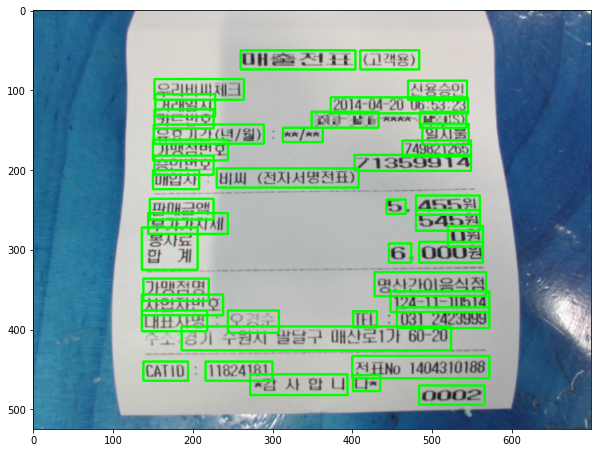

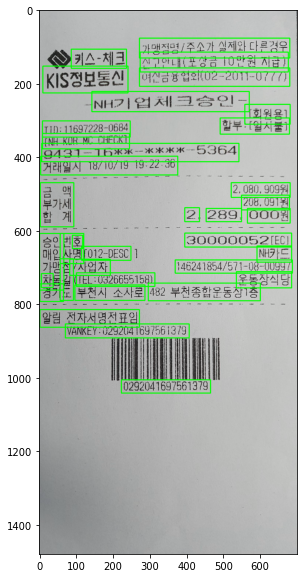

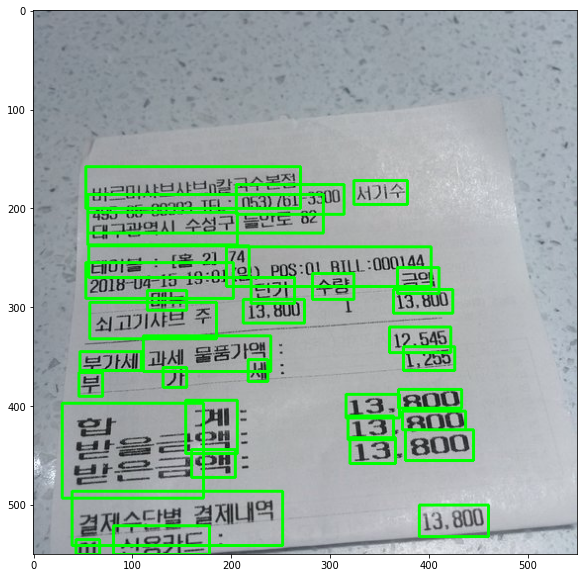

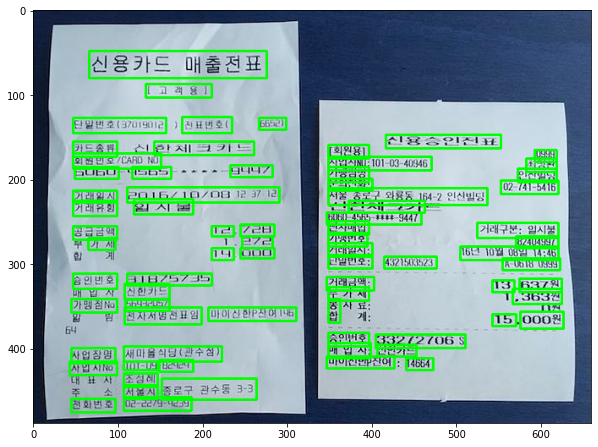

In [ ]:
files = glob.glob("./영수증_1/" + "*.jpg")
# 파일명 
for file in files:  
    reader = easyocr.Reader(['ko'], gpu=True) # GPU 사용
    result = reader.readtext(file)
    img = cv2.imread(file)

    n_boxes = len(result)
    for i in range(n_boxes):
        if result[i][2] > 0:
            (x, y, w, h) = (result[i][0][3][0], result[i][0][0][1], result[i][0][1][0]-result[i][0][3][0], result[i][0][2][1]-result[i][0][0][1])
            x, y, w, h = int(x), int(y), int(w), int(h)
            img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # cv2.imshow('img', img)
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    plt.show()

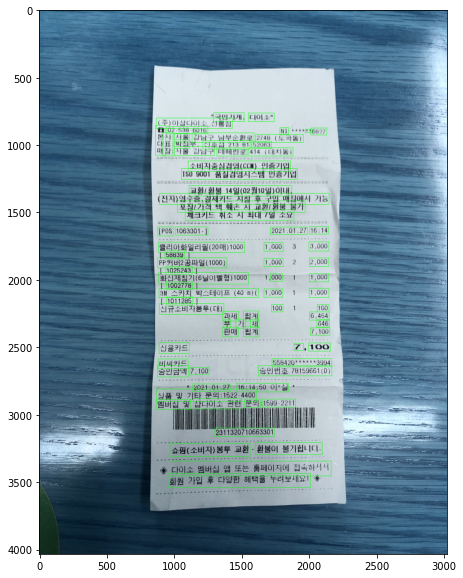

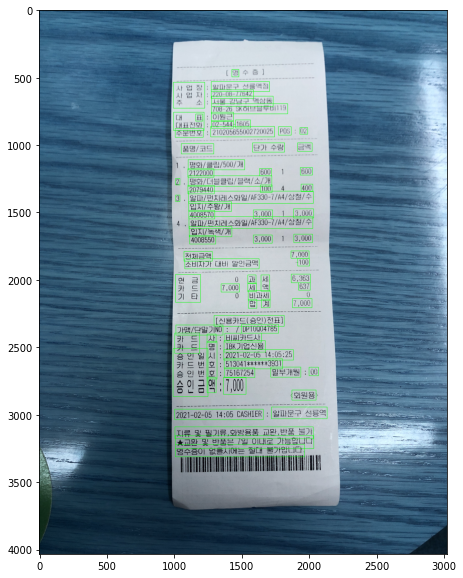

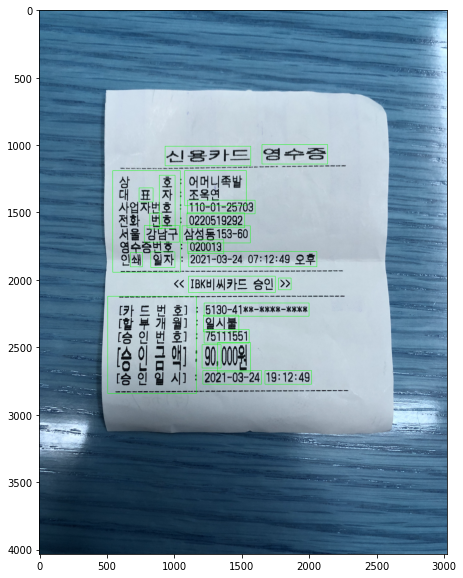

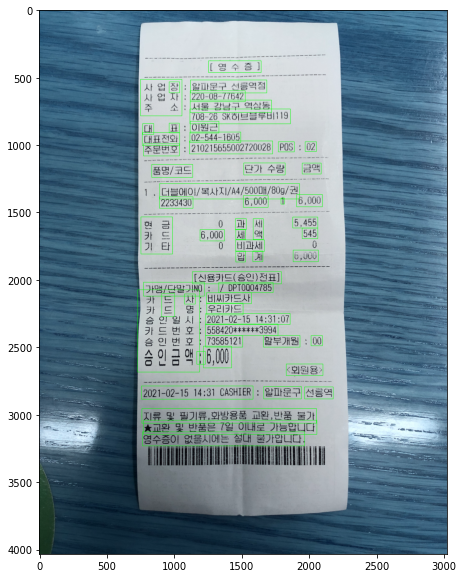

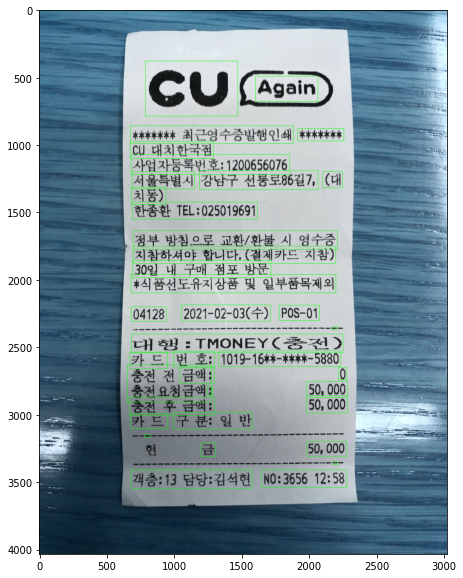

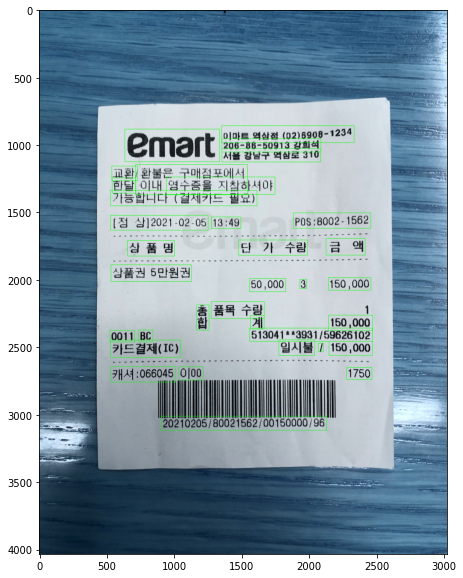

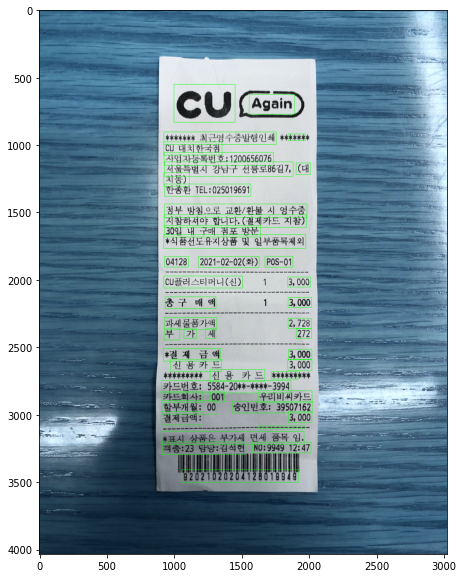

In [ ]:
files = glob.glob("./영수증_2/phone_pic/" + "*.jpg")
# 파일명 
for file in files:  
    reader = easyocr.Reader(['ko'], gpu=True) # GPU 사용
    result = reader.readtext(file)
    img = cv2.imread(file)

    n_boxes = len(result)
    for i in range(n_boxes):
        if result[i][2] > 0:
            (x, y, w, h) = (result[i][0][3][0], result[i][0][0][1], result[i][0][1][0]-result[i][0][3][0], result[i][0][2][1]-result[i][0][0][1])
            img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # cv2.imshow('img', img)
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    plt.show()

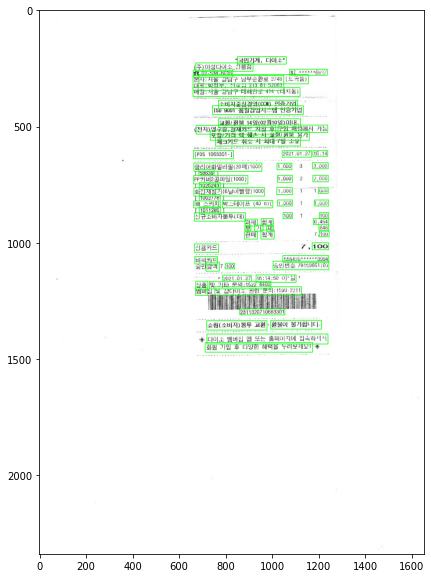

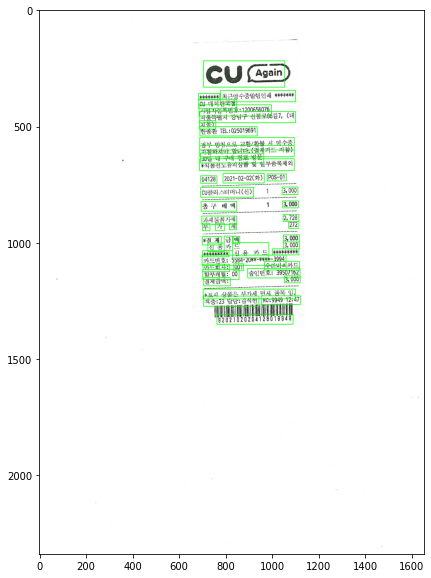

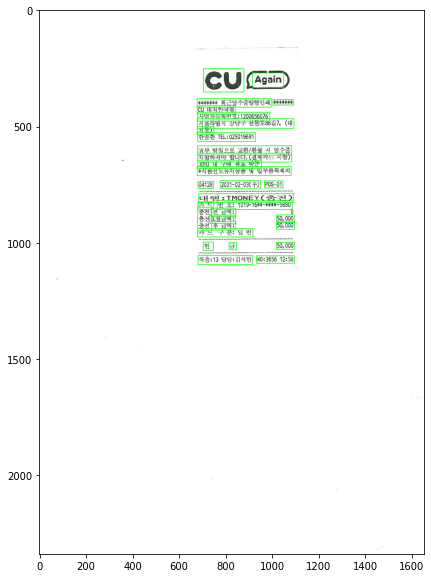

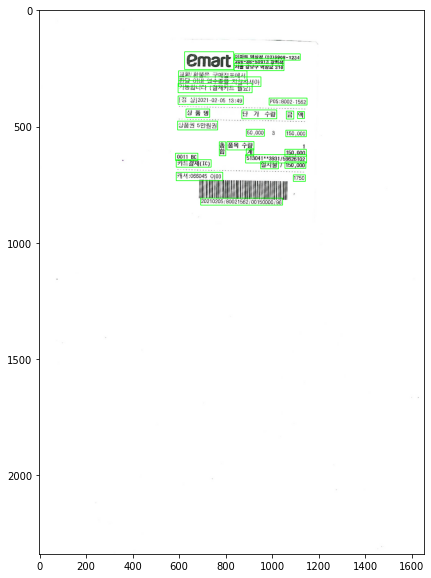

TypeError: ignored

In [ ]:
files = glob.glob("./영수증_2/scan/" + "*.jpg")
# 파일명 
for file in files:  
    reader = easyocr.Reader(['ko'], gpu=True) # GPU 사용
    result = reader.readtext(file)
    img = cv2.imread(file)

    n_boxes = len(result)
    for i in range(n_boxes):
        if result[i][2] > 0:
            (x, y, w, h) = (result[i][0][3][0], result[i][0][0][1], result[i][0][1][0]-result[i][0][3][0], result[i][0][2][1]-result[i][0][0][1])
            x, y, w, h = int(x), int(y), int(w), int(h)
            img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # cv2.imshow('img', img)
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    plt.show()

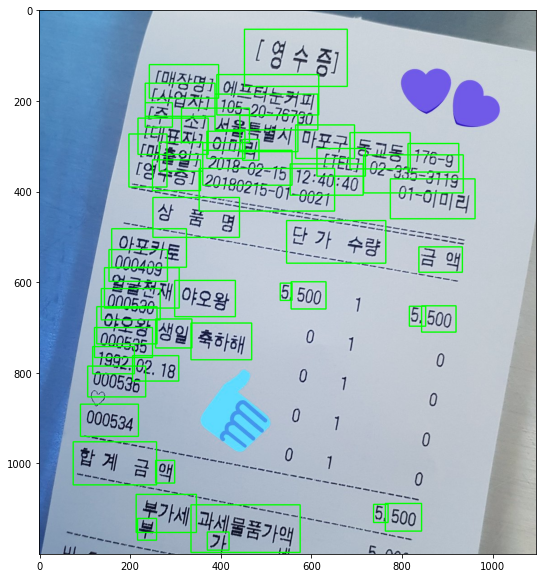

In [ ]:
# phone-pic
reader = easyocr.Reader(['ko'], gpu=True) # GPU 사용
result = reader.readtext('./영수증_1/04.jpg')
img = cv2.imread('./영수증_1/04.jpg')

n_boxes = len(result)
for i in range(n_boxes):
    if result[i][2] > 0:
        (x, y, w, h) = (result[i][0][3][0], result[i][0][0][1], result[i][0][1][0]-result[i][0][3][0], result[i][0][2][1]-result[i][0][0][1])
        x, y, w, h = int(x), int(y), int(w), int(h)
        img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

# cv2.imshow('img', img)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.show()

In [ ]:
result = reader.readtext('./영수증_1/04.jpg', detail=0)
[each for each in result]

['[주',
 '숲 서울',
 '출일]',
 '리',
 '금 액',
 '5',
 '5,',
 '생일',
 '02. 18',
 '액',
 '5,',
 '부',
 '가',
 '[영수증]',
 '[매장명]',
 '에프터눈커피',
 '[사업자]',
 '105-20-76730',
 '특별시',
 '[대표자]',
 '마포구',
 '이미',
 '동교통',
 '[',
 '176-9',
 '[7.-]',
 '2018-02-15',
 '02-335-3119',
 '수층]',
 '12:40:40',
 '20180215-01-0021',
 '01-이미리',
 '상 품 명',
 '단 가   수량',
 '아포카토',
 '000409',
 '얼굴천재',
 '야오왕',
 '500',
 '000530',
 '500',
 '야오왕',
 '축하해',
 '000535',
 '1992.',
 '000536',
 '000534',
 '합 계   금',
 '부가세',
 '500',
 '과세물품가액']